### Texture Synthesis Using Convolutional Neural Networks (Gatys et al.)
(Source: https://arxiv.org/abs/1505.07376)

Following the implementation in caffe at https://github.com/leongatys/DeepTextures/blob/master/Example.ipynb

Likely a good start for using pyTorch at https://github.com/honzukka/texture-synthesis-pytorch

In [1]:
%matplotlib inline

import os
import glob
import sys

import torch
import matplotlib.pyplot as plt
import numpy as np
import cv2
from PIL import Image

base_dir = os.getcwd()
sys.path.append(base_dir)
im_dir = os.path.join(base_dir, 'images/')

imagenet_mean = np.array([ 0.48501961,  0.45795686, 0.40760392 ]) # Imagenet Mean (RGB)

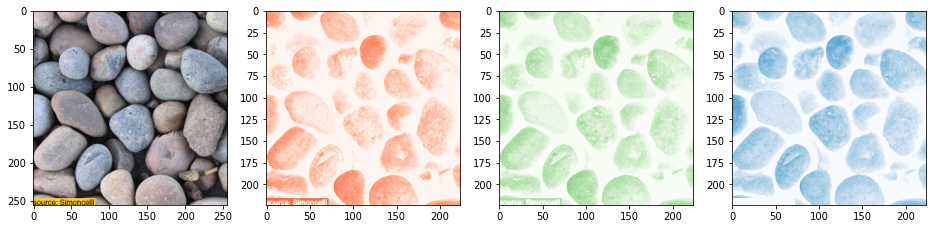

In [2]:
def load_image(file_name, resize_shape=None, vmax=255., mean=imagenet_mean, normalize=True, show_img=False):
    img = Image.open(os.path.join(im_dir, file_name))
    img = np.array(img, dtype=float)
    img /= vmax
    
    if resize_shape is not None:
        img = cv2.resize(img, resize_shape)
    
    if show_img:
        plt.imshow(img)
    
    if normalize:
        img[:,:,0] -= mean[0]
        img[:,:,1] -= mean[1]
        img[:,:,2] -= mean[2]
             
    return img

img = load_image('pebbles.jpg', resize_shape=(224,224))

fig, axs = plt.subplots(1,4, figsize=(16,4))
axs[0].imshow(load_image('pebbles.jpg', normalize=False))
axs[1].imshow(img[:,:,0], vmin=0, vmax=1, cmap='Reds')
axs[2].imshow(img[:,:,1], vmin=0, vmax=1, cmap='Greens')
axs[3].imshow(img[:,:,2], vmin=0, vmax=1, cmap='Blues')

In [30]:
model = torch.hub.load('pytorch/vision:v0.10.0', 'vgg19', pretrained=False)
model

Using cache found in /home/claude/.cache/torch/hub/pytorch_vision_v0.10.0


VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

In [82]:
model = model.double()
model.to('cpu')

i = np.rollaxis(img, 2, 0)
img_tensor = torch.from_numpy(i.reshape((1,) + i.shape)).double()
output = model.features(img_tensor).to('cpu')

output.shape

torch.Size([1, 512, 7, 7])

3136

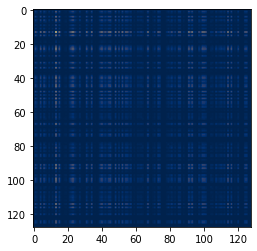

In [133]:
def gram_matrix(activations):
    N = activations.shape[1]
    F = activations.reshape(N, -1)
    M = F.shape[1]
    G = np.dot(F, F.T) / M
    return G

g = gram_matrix(output.detach().numpy())
plt.imshow(g, cmap='cividis')

o = output.detach().numpy()


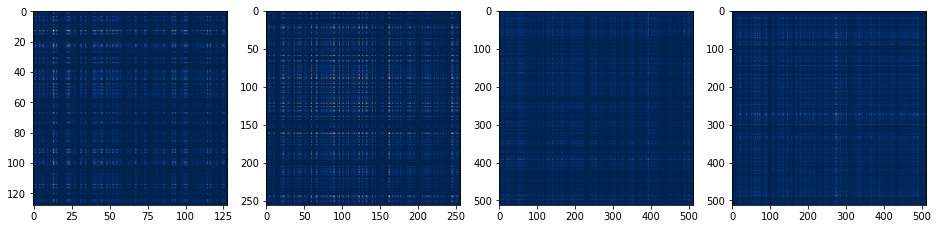

In [130]:
def plot_gram_at(last_layer_index):
    partial_net = torch.nn.Sequential()
    for idx, layer in enumerate(list(model.features)[0:last_layer_index+1]):
        partial_net.add_module(str(idx), layer)

    output = partial_net(img_tensor)
    return gram_matrix(output.detach().numpy())

fig, axs = plt.subplots(1, 4, figsize=(16,4))

axs[0].imshow(plot_gram_at(9), cmap='cividis')
axs[1].imshow(plot_gram_at(18), cmap='cividis')
axs[2].imshow(plot_gram_at(27), cmap='cividis')
axs[3].imshow(plot_gram_at(36), cmap='cividis')

step: 1, loss: 1050783232.0 (29.50s)
image ready!


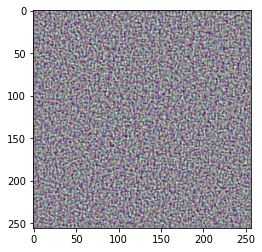

step: 2, loss: 777050176.0 (19.70s)
image ready!


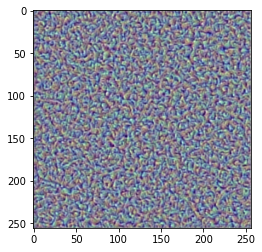

step: 3, loss: 420175424.0 (19.71s)
image ready!


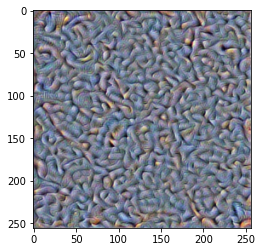

step: 4, loss: 272444736.0 (19.73s)
image ready!


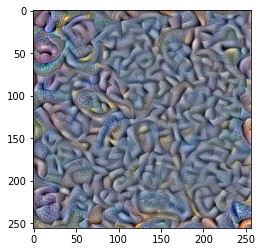

step: 5, loss: 164761936.0 (19.87s)
image ready!


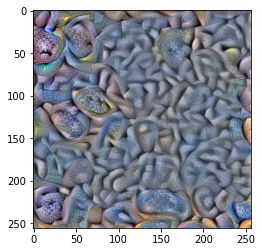

step: 6, loss: 113401448.0 (21.35s)
image ready!


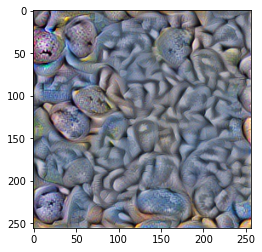

step: 7, loss: 79996832.0 (19.75s)
image ready!


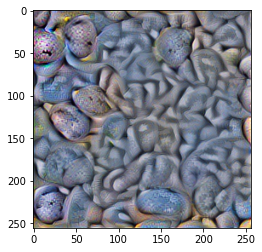

step: 8, loss: 58490056.0 (19.80s)
image ready!


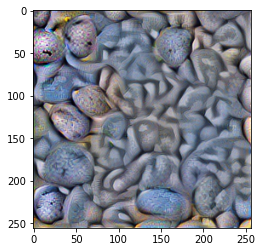

step: 9, loss: 43608736.0 (19.76s)
image ready!


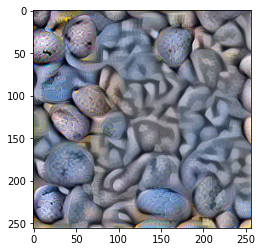

step: 10, loss: 33977448.0 (19.75s)
image ready!


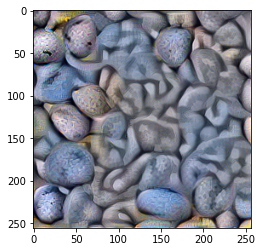

step: 11, loss: 27709882.0 (21.44s)
image ready!


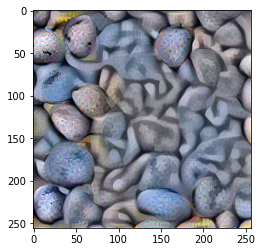

step: 12, loss: 21706538.0 (19.80s)
image ready!


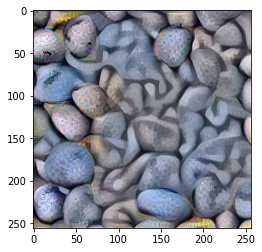

step: 13, loss: 18666640.0 (19.83s)
image ready!


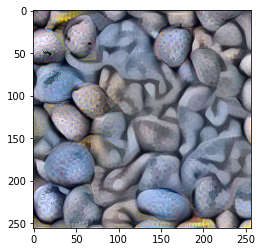

step: 14, loss: 15972474.0 (19.80s)
image ready!


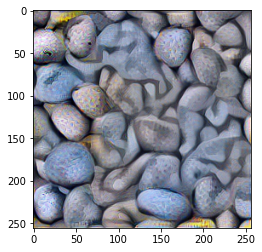

step: 15, loss: 13138909.0 (19.84s)
image ready!


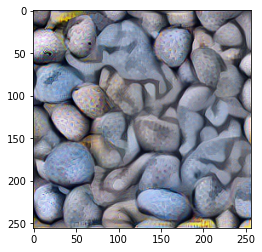

step: 16, loss: 11279822.0 (19.82s)
image ready!


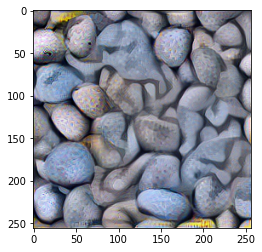

step: 17, loss: 9797976.0 (20.17s)
image ready!


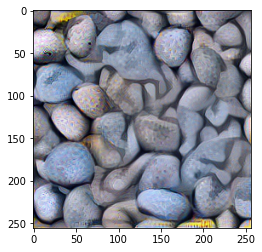

step: 18, loss: 8628707.0 (19.86s)
image ready!


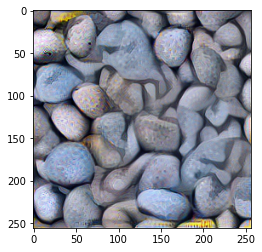

step: 19, loss: 7685463.0 (19.85s)
image ready!


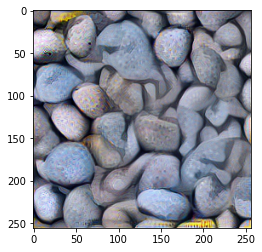

step: 20, loss: 6884282.0 (19.87s)
image ready!


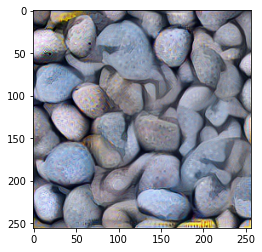

step: 21, loss: 6334646.5 (19.87s)
image ready!


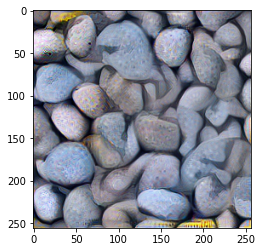

step: 22, loss: 5845576.5 (19.82s)
image ready!


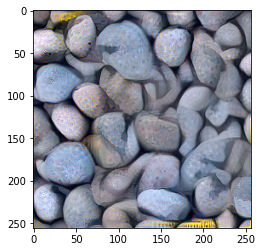

step: 23, loss: 5513320.5 (20.18s)
image ready!


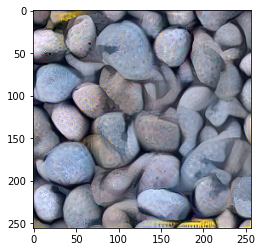

step: 24, loss: 5084093.0 (19.85s)
image ready!


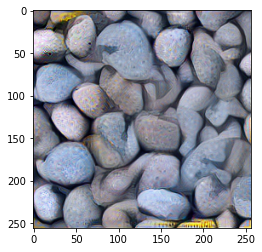

step: 25, loss: 4795388.0 (19.79s)
image ready!


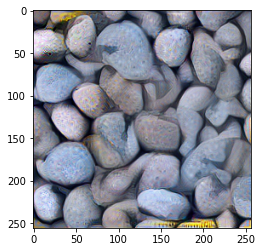

step: 26, loss: 4519186.5 (19.83s)
image ready!


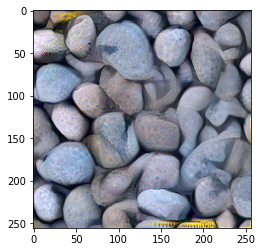

step: 27, loss: 4260767.5 (19.84s)
image ready!


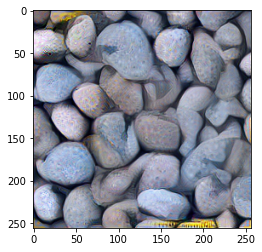

step: 28, loss: 3981604.75 (19.82s)
image ready!


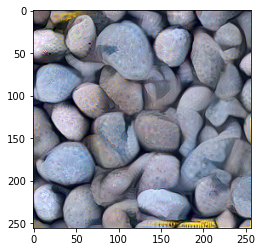

step: 29, loss: 3807342.5 (20.29s)
image ready!


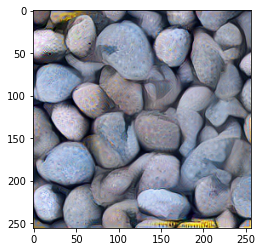

step: 30, loss: 3625282.0 (19.84s)
image ready!


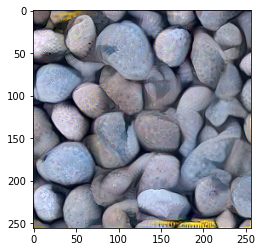

step: 31, loss: 3480040.0 (19.84s)
image ready!


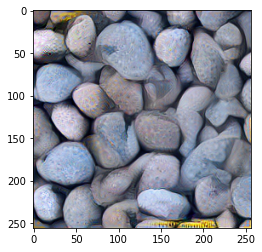

step: 32, loss: 3335052.0 (19.83s)
image ready!


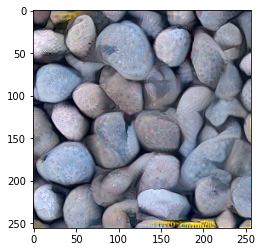

step: 33, loss: 3208727.0 (19.83s)
image ready!


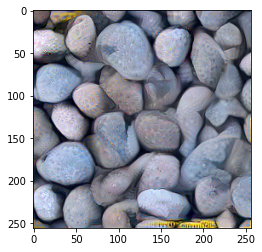

step: 34, loss: 3117588.0 (19.84s)
image ready!


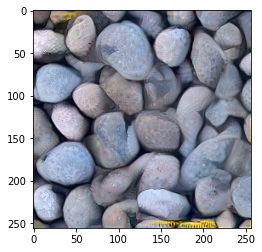

step: 35, loss: 3013641.5 (20.46s)
image ready!


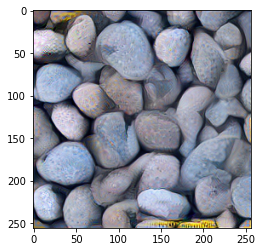

step: 36, loss: 2923852.25 (19.83s)
image ready!


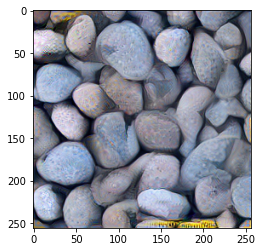

step: 37, loss: 2851040.0 (19.82s)
image ready!


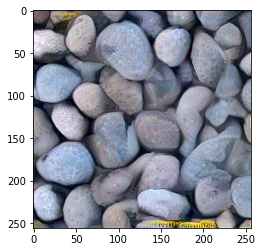

step: 38, loss: 2770987.0 (19.81s)
image ready!


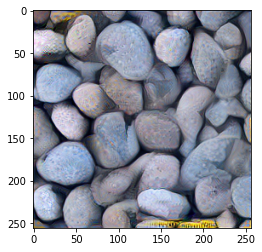

step: 39, loss: 2708088.0 (19.83s)
image ready!


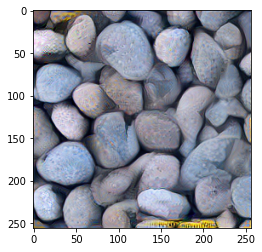

step: 40, loss: 2652040.5 (19.80s)
image ready!


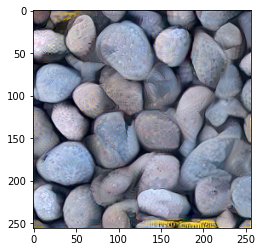

step: 41, loss: 2599839.0 (21.78s)
image ready!


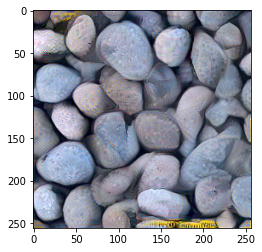

step: 42, loss: 2543262.5 (19.83s)
image ready!


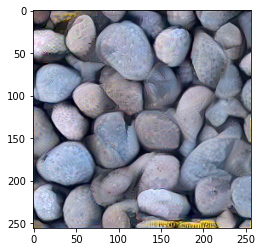

step: 43, loss: 2497651.75 (19.84s)
image ready!


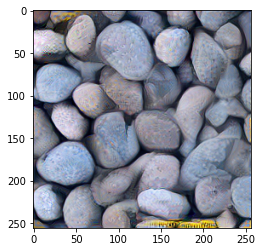

step: 44, loss: 2449134.0 (19.83s)
image ready!


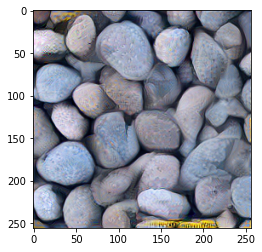

step: 45, loss: 2407984.75 (19.84s)
image ready!


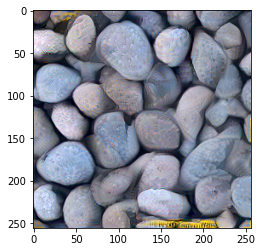

step: 46, loss: 2368731.75 (19.83s)
image ready!


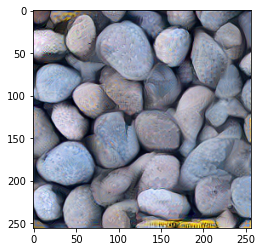

step: 47, loss: 2333750.5 (20.58s)
image ready!


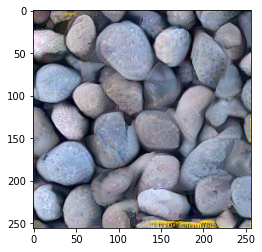

step: 48, loss: 2302040.25 (19.84s)
image ready!


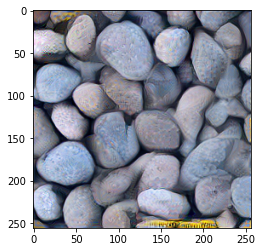

step: 49, loss: 2271567.0 (19.82s)
image ready!


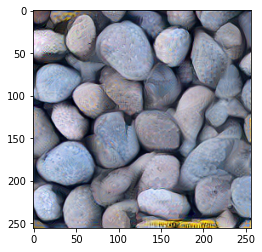

step: 50, loss: 2234079.75 (19.82s)
image ready!


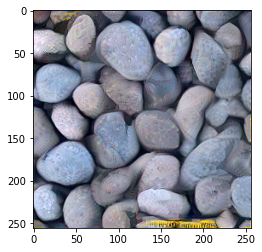

step: 51, loss: 2204054.0 (19.80s)
image ready!


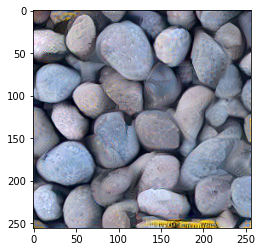

step: 52, loss: 2176392.25 (19.81s)
image ready!


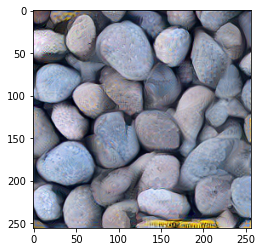

step: 53, loss: 2146294.0 (20.54s)
image ready!


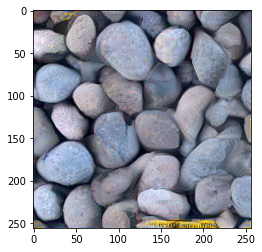

step: 54, loss: 2121320.5 (19.82s)
image ready!


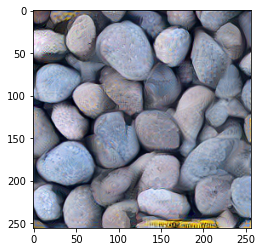

step: 55, loss: 2096371.625 (19.83s)
image ready!


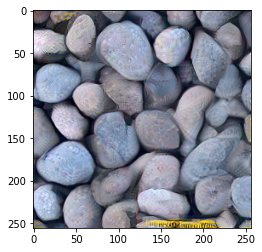

step: 56, loss: 2071068.25 (19.84s)
image ready!


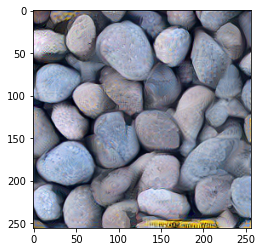

step: 57, loss: 2055226.0 (19.86s)
image ready!


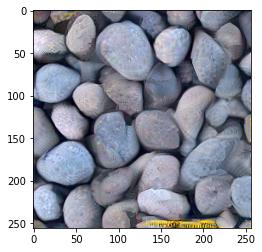

step: 58, loss: 2033531.875 (19.85s)
image ready!


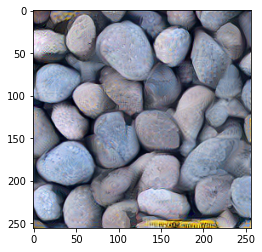

step: 59, loss: 2013960.0 (20.72s)
image ready!


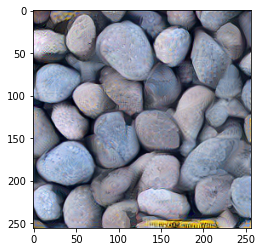

step: 60, loss: 1993851.375 (19.84s)
image ready!


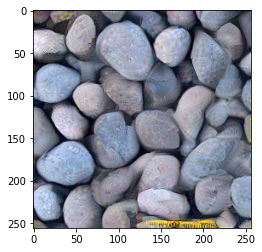

step: 61, loss: 1976892.25 (19.81s)
image ready!


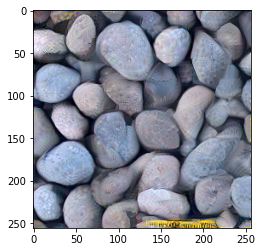

step: 62, loss: 1959076.625 (19.85s)
image ready!


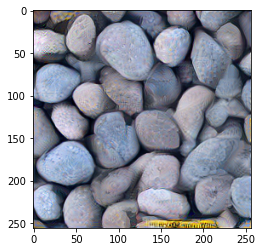

step: 63, loss: 1940592.375 (19.85s)
image ready!


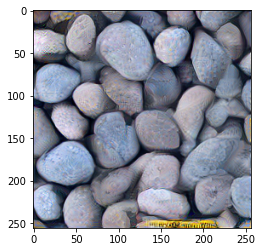

step: 64, loss: 1923852.75 (19.83s)
image ready!


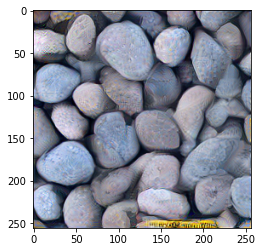

step: 65, loss: 1910202.875 (20.76s)
image ready!


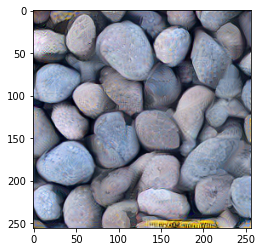

step: 66, loss: 1896099.5 (19.82s)
image ready!


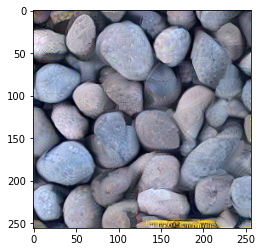

step: 67, loss: 1881241.25 (19.84s)
image ready!


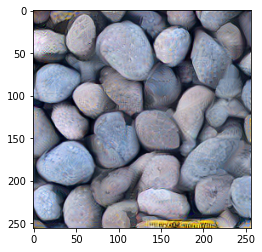

step: 68, loss: 1866713.125 (19.81s)
image ready!


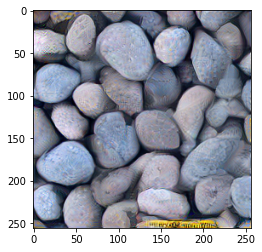

step: 69, loss: 1853756.125 (19.84s)
image ready!


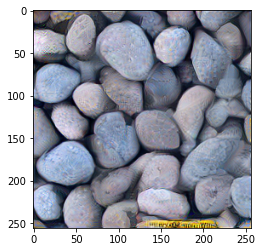

step: 70, loss: 1840932.875 (19.84s)
image ready!


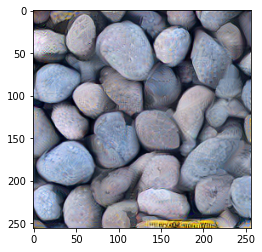

step: 71, loss: 1827038.5 (22.27s)
image ready!


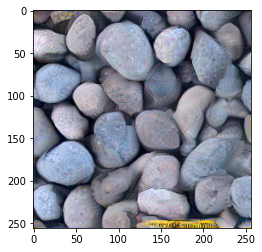

step: 72, loss: 1812997.25 (19.89s)
image ready!


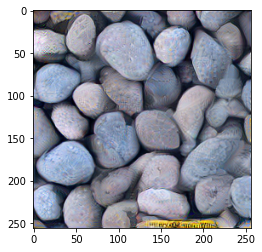

step: 73, loss: 1802047.25 (19.84s)
image ready!


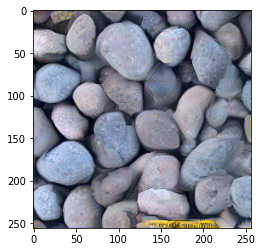

step: 74, loss: 1790519.375 (19.83s)
image ready!


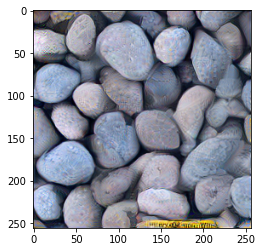

step: 75, loss: 1778680.875 (19.87s)
image ready!


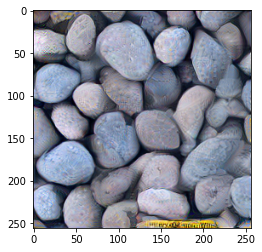

step: 76, loss: 1767910.25 (20.52s)
image ready!


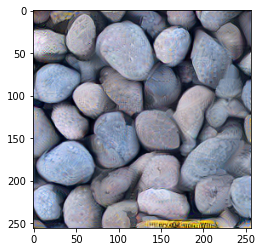

step: 77, loss: 1757347.5 (20.13s)
image ready!


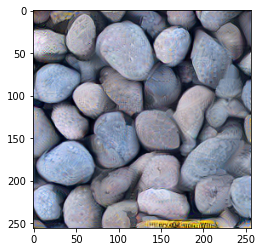

step: 78, loss: 1747808.875 (19.88s)
image ready!


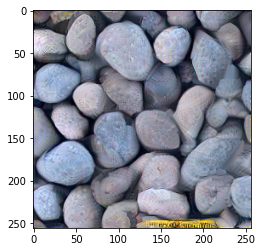

step: 79, loss: 1738563.375 (19.83s)
image ready!


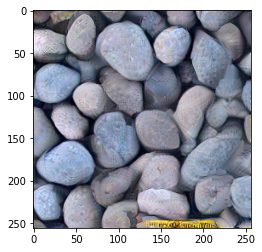

step: 80, loss: 1727665.25 (19.83s)
image ready!


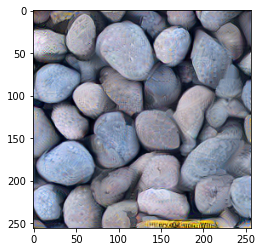

step: 81, loss: 1719283.5 (19.83s)
image ready!


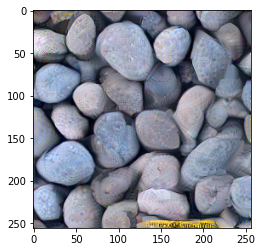

step: 82, loss: 1710203.25 (20.96s)
image ready!


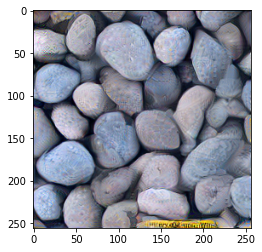

step: 83, loss: 1701310.125 (19.81s)
image ready!


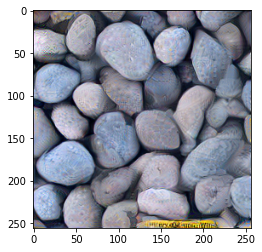

step: 84, loss: 1692198.125 (19.86s)
image ready!


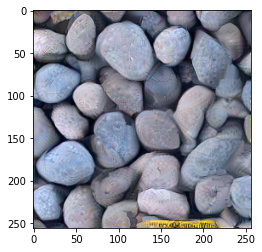

step: 85, loss: 1684947.0 (19.91s)
image ready!


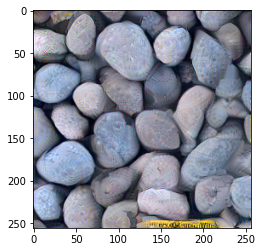

step: 86, loss: 1675899.75 (19.88s)
image ready!


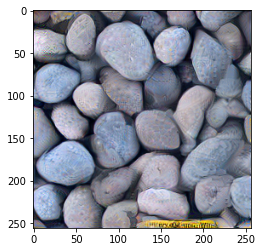

step: 87, loss: 1668190.0 (19.82s)
image ready!


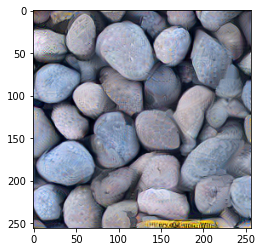

step: 88, loss: 1660204.625 (21.02s)
image ready!


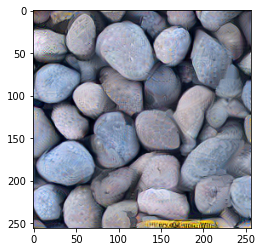

step: 89, loss: 1652933.375 (19.83s)
image ready!


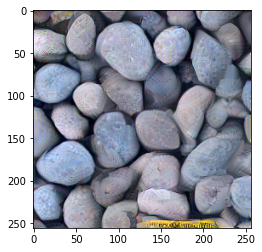

step: 90, loss: 1644631.75 (19.82s)
image ready!


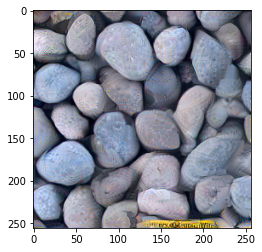

step: 91, loss: 1637930.0 (19.83s)
image ready!


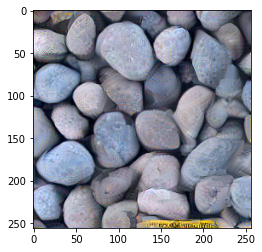

step: 92, loss: 1630533.75 (19.83s)
image ready!


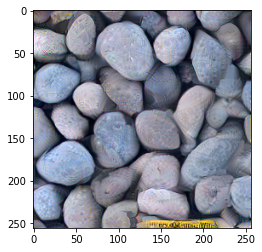

step: 93, loss: 1623915.25 (19.83s)
image ready!


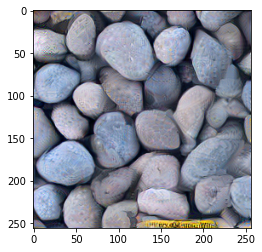

step: 94, loss: 1616735.625 (20.94s)
image ready!


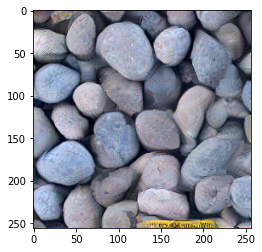

step: 95, loss: 1610050.0 (19.87s)
image ready!


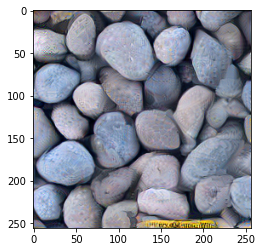

step: 96, loss: 1603711.375 (19.83s)
image ready!


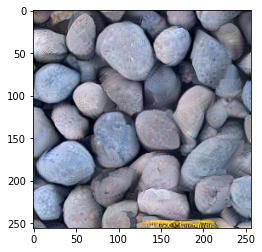

step: 97, loss: 1597621.0 (19.86s)
image ready!


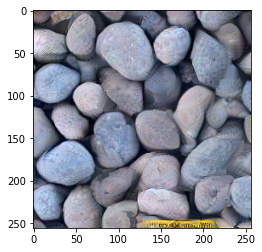

step: 98, loss: 1592193.0 (19.89s)
image ready!


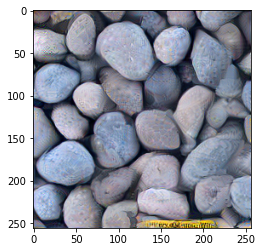

step: 99, loss: 1586512.875 (19.87s)
image ready!


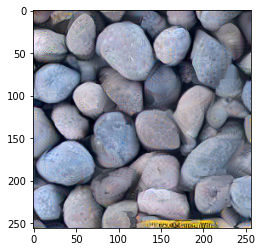

step: 100, loss: 1581747.5 (22.80s)
image ready!


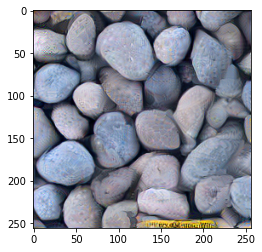

In [7]:
sys.path.append(os.path.join(base_dir, 'texture_synthesis_pytorch'))

import utilities
import model
import optimize

import importlib
importlib.reload(utilities)
importlib.reload(model)
importlib.reload(optimize)


import collections.abc as container_abcs

from argparse import Namespace
args = Namespace(**{
    'checkpoint_every': 1,
    'n_steps': 100,
    'max_iter': 5,
    'lr': 1.0
})

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

target_image = utilities.preprocess_image(utilities.load_image(os.path.join(im_dir, 'pebbles.jpg')))

net = model.Model(os.path.join(base_dir, 'models', 'VGG19_normalized_avg_pool_pytorch'), device, target_image)

optimizer = optimize.Optimizer(net, args)
result = optimizer.optimize()

final_image = utilities.postprocess_image(result, utilities.load_image(os.path.join(im_dir, 'pebbles.jpg')))
final_image.save('output.png')

step: 1, loss: 6637214208.0 (31.03s)


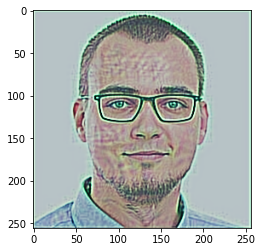

step: 2, loss: 1496284416.0 (19.97s)


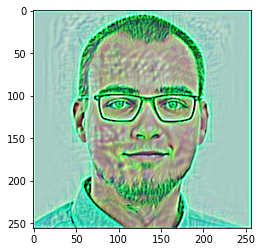

step: 3, loss: 365327200.0 (19.98s)


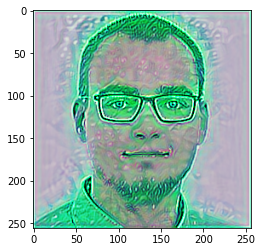

step: 4, loss: 128597280.0 (20.04s)


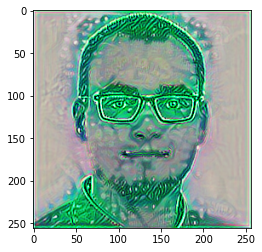

step: 5, loss: 76231704.0 (21.46s)


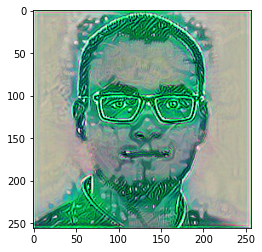

step: 6, loss: 29259894.0 (20.01s)


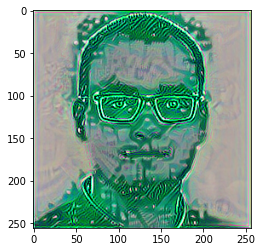

step: 7, loss: 16506108.0 (20.02s)


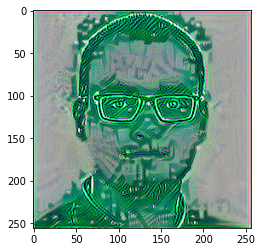

step: 8, loss: 12802108.0 (20.05s)


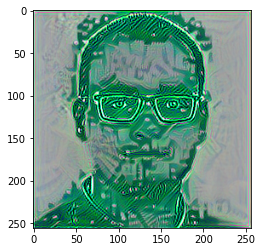

step: 9, loss: 8496553.0 (23.35s)


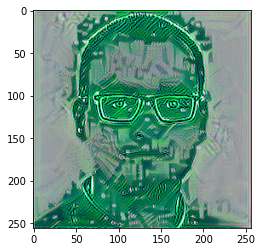

step: 10, loss: 6504043.5 (20.01s)


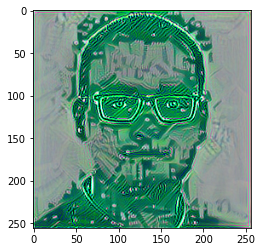

step: 11, loss: 5097777.0 (21.45s)


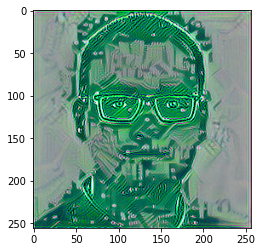

step: 12, loss: 4511719.0 (19.88s)


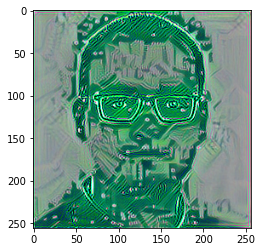

step: 13, loss: 3919020.5 (19.89s)


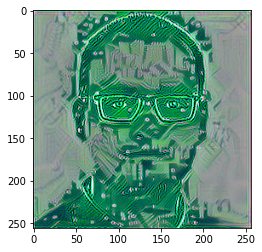

step: 14, loss: 3477605.25 (19.91s)


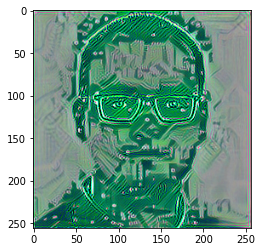

step: 15, loss: 3151420.75 (19.93s)


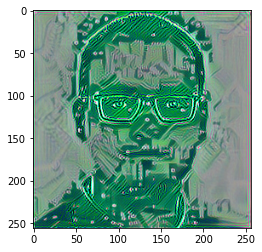

step: 16, loss: 2807491.0 (19.89s)


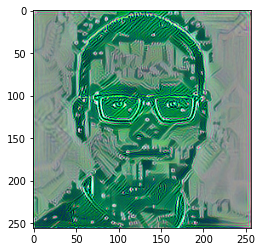

step: 17, loss: 2460146.0 (22.64s)


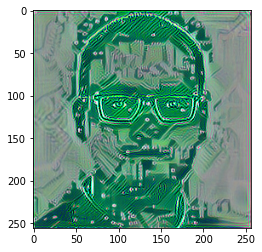

step: 18, loss: 2275542.25 (19.93s)


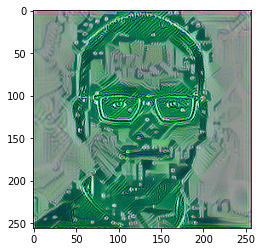

step: 19, loss: 2065811.625 (19.94s)


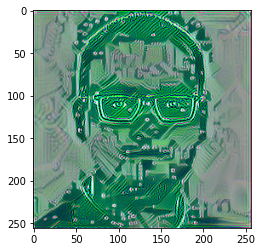

step: 20, loss: 1873475.25 (19.94s)


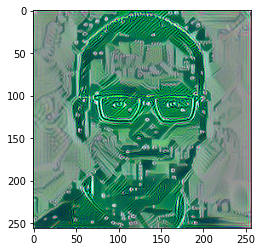

step: 21, loss: 1714270.625 (19.99s)


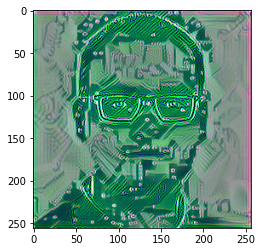

step: 22, loss: 1585295.5 (19.95s)


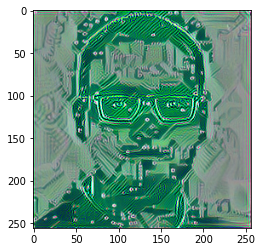

step: 23, loss: 1495613.75 (21.61s)


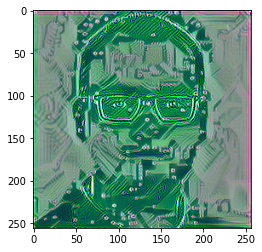

step: 24, loss: 1400408.625 (19.95s)


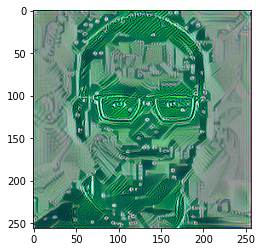

step: 25, loss: 1286554.75 (19.96s)


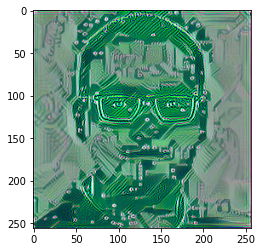

step: 26, loss: 1232755.5 (19.97s)


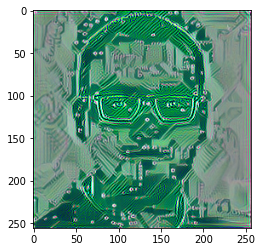

step: 27, loss: 1157641.875 (19.94s)


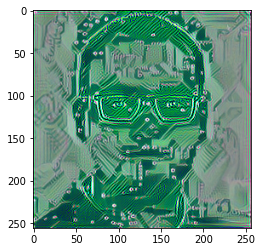

step: 28, loss: 1104009.5 (19.96s)


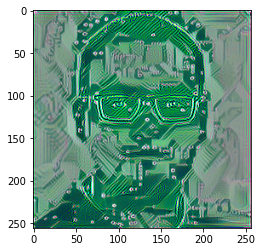

step: 29, loss: 1041294.375 (21.55s)


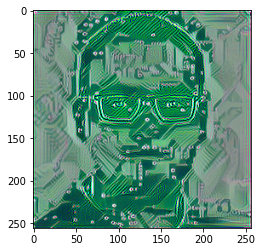

step: 30, loss: 994018.8125 (19.97s)


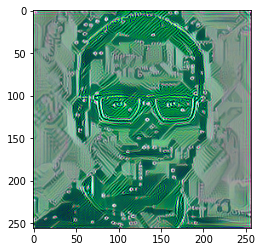

step: 31, loss: 945398.4375 (20.00s)


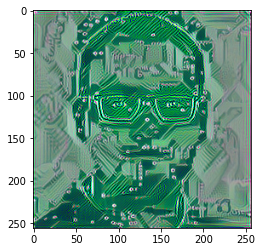

step: 32, loss: 904709.125 (19.96s)


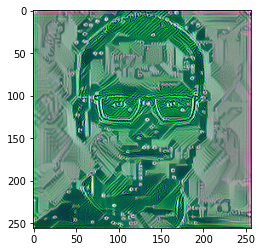

step: 33, loss: 874596.9375 (19.95s)


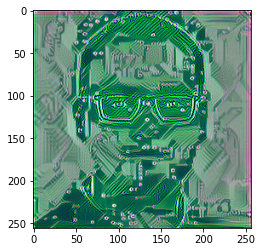

step: 34, loss: 835247.875 (22.03s)


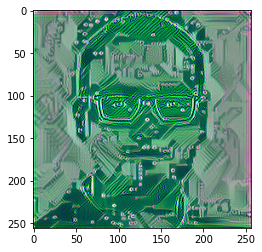

step: 35, loss: 802967.4375 (20.01s)


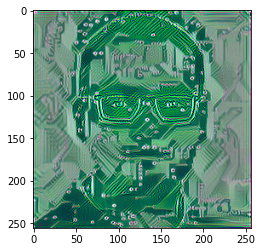

step: 36, loss: 772574.625 (19.96s)


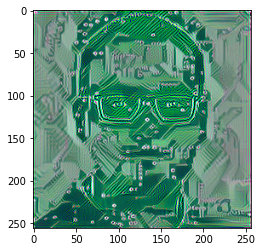

step: 37, loss: 742697.5 (19.96s)


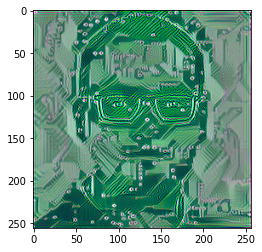

step: 38, loss: 715106.25 (20.06s)


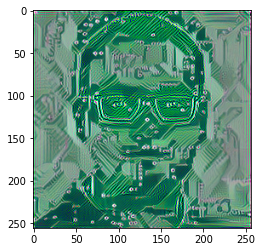

step: 39, loss: 695392.5625 (20.01s)


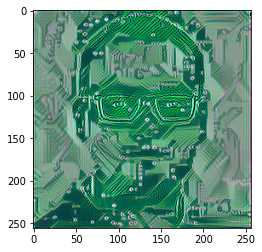

step: 40, loss: 671627.3125 (21.98s)


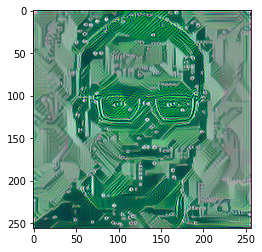

step: 41, loss: 652870.9375 (19.97s)


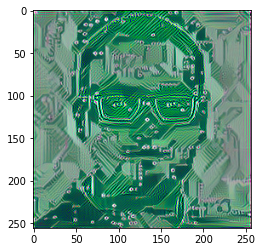

step: 42, loss: 634317.4375 (19.96s)


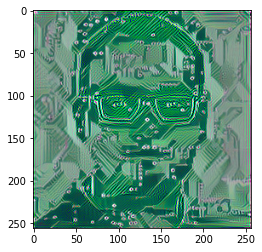

step: 43, loss: 614080.3125 (19.98s)


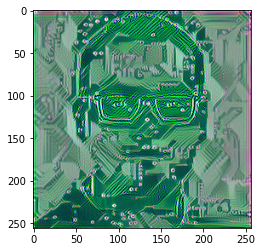

step: 44, loss: 601942.3125 (19.99s)


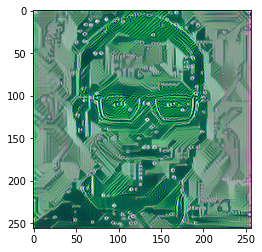

step: 45, loss: 582124.75 (19.97s)


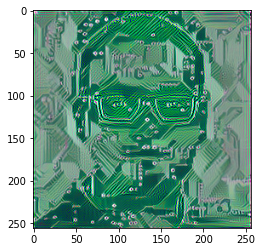

step: 46, loss: 569457.375 (24.82s)


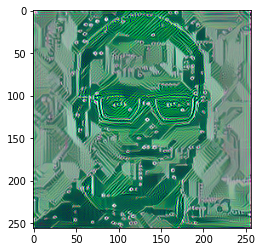

step: 47, loss: 555159.1875 (20.82s)


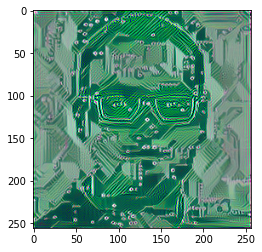

step: 48, loss: 542583.8125 (20.00s)


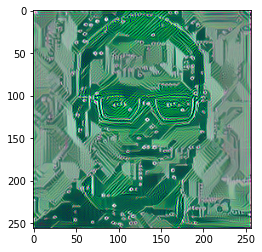

step: 49, loss: 527782.4375 (20.02s)


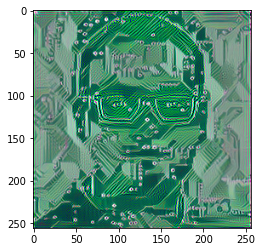

step: 50, loss: 517075.25 (20.01s)


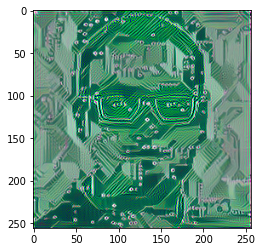

step: 51, loss: 507144.8125 (19.99s)


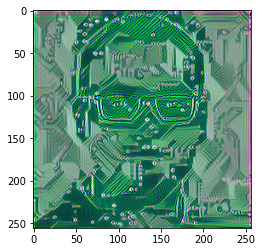

step: 52, loss: 495558.875 (21.90s)


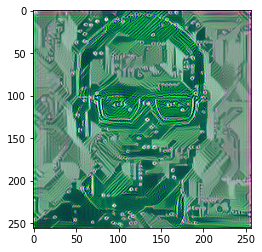

step: 53, loss: 486798.5 (19.95s)


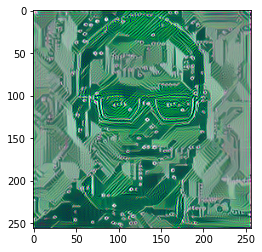

step: 54, loss: 478686.125 (19.95s)


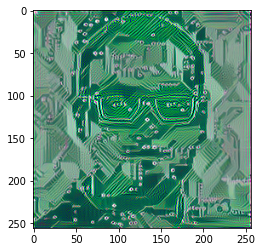

step: 55, loss: 466865.6875 (19.97s)


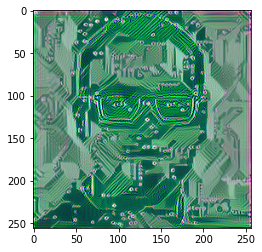

step: 56, loss: 460789.0 (19.96s)


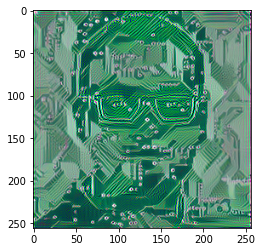

step: 57, loss: 452851.15625 (19.98s)


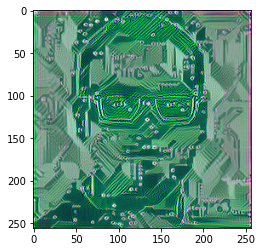

step: 58, loss: 444492.28125 (22.23s)


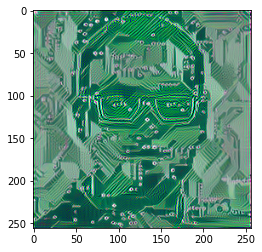

step: 59, loss: 437440.6875 (20.03s)


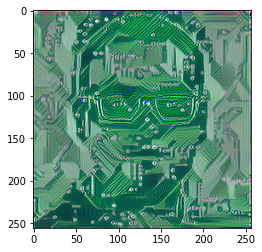

step: 60, loss: 429355.6875 (19.96s)


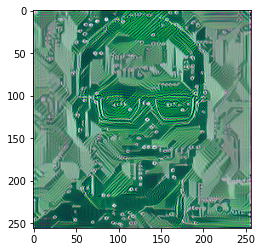

step: 61, loss: 424927.6875 (20.00s)


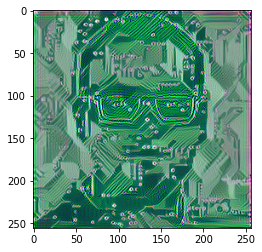

step: 62, loss: 419179.9375 (20.03s)


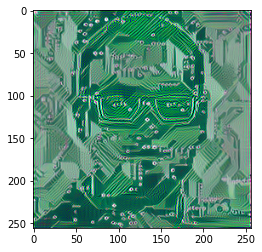

step: 63, loss: 411611.125 (20.27s)


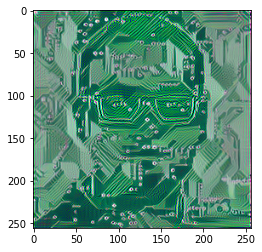

step: 64, loss: 404800.125 (21.83s)


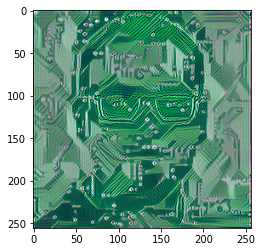

step: 65, loss: 399708.28125 (19.96s)


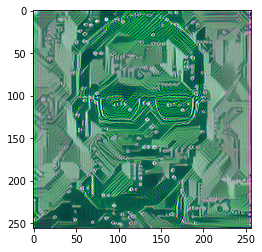

step: 66, loss: 394023.1875 (20.02s)


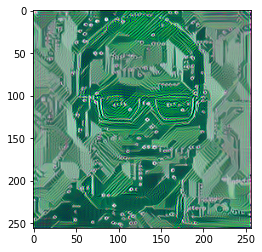

step: 67, loss: 389968.28125 (19.96s)


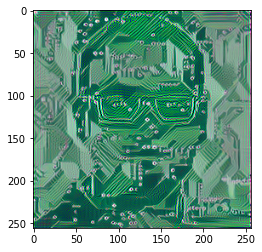

step: 68, loss: 384235.625 (19.96s)


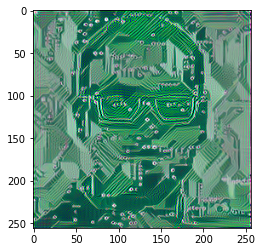

step: 69, loss: 380089.78125 (22.09s)


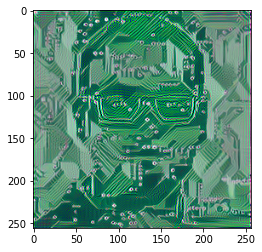

step: 70, loss: 375607.375 (19.97s)


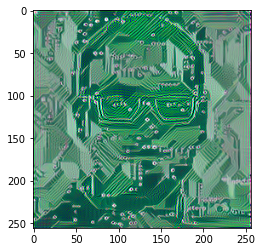

step: 71, loss: 371160.0625 (19.96s)


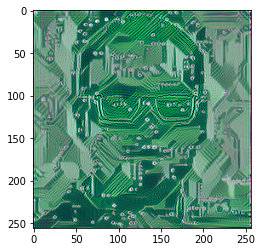

step: 72, loss: 367381.96875 (20.06s)


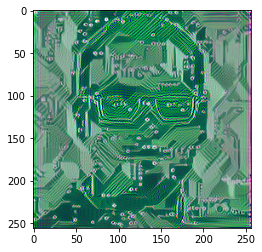

step: 73, loss: 362801.0 (19.96s)


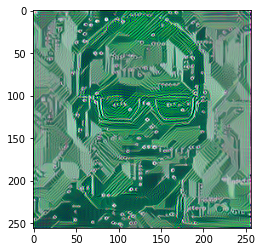

step: 74, loss: 358580.6875 (19.98s)


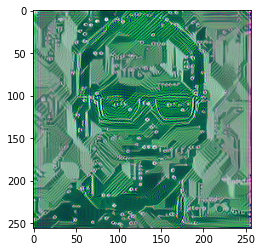

step: 75, loss: 355100.8125 (23.01s)


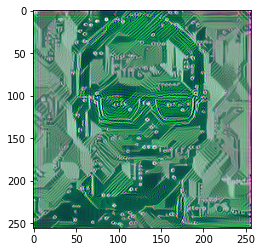

step: 76, loss: 351405.5625 (20.00s)


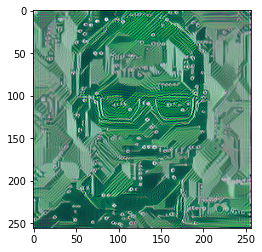

step: 77, loss: 348310.8125 (19.97s)


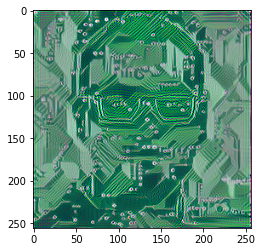

step: 78, loss: 345133.0 (19.97s)


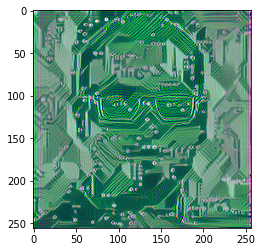

step: 79, loss: 341737.5625 (19.97s)


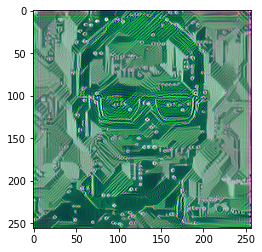

step: 80, loss: 338661.28125 (19.96s)


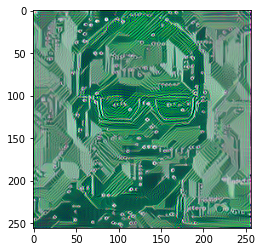

step: 81, loss: 335276.0 (22.40s)


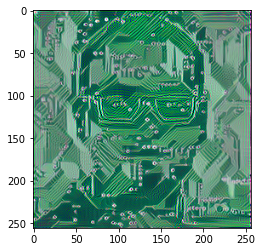

step: 82, loss: 332559.875 (19.98s)


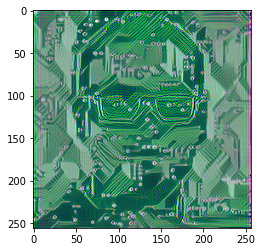

step: 83, loss: 329201.5625 (19.95s)


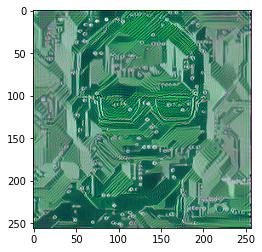

step: 84, loss: 326914.78125 (19.95s)


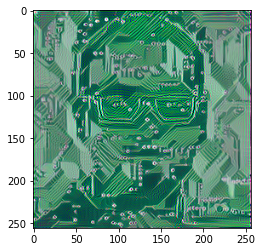

step: 85, loss: 324233.46875 (19.99s)


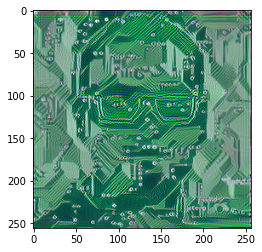

step: 86, loss: 321802.78125 (19.96s)


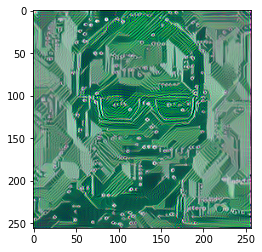

step: 87, loss: 319031.46875 (22.50s)


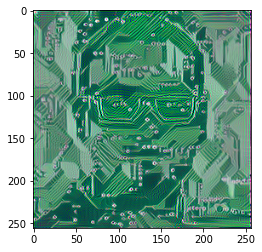

step: 88, loss: 315974.3125 (19.96s)


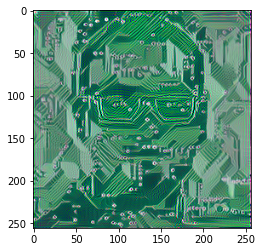

step: 89, loss: 313939.25 (19.97s)


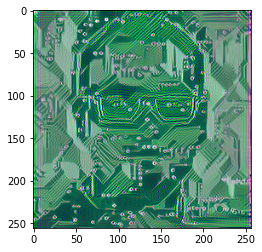

step: 90, loss: 311573.34375 (20.00s)


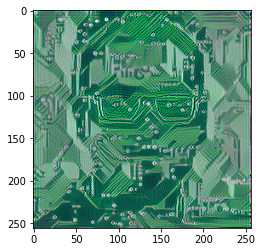

step: 91, loss: 309500.84375 (19.95s)


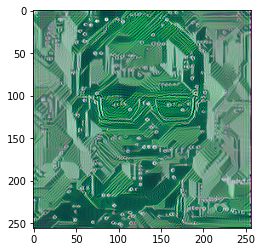

step: 92, loss: 306939.15625 (19.94s)


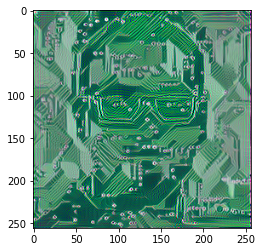

step: 93, loss: 304426.5625 (22.85s)


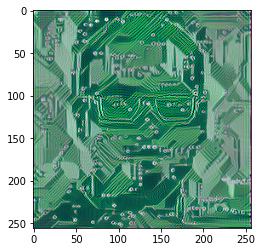

step: 94, loss: 302762.3125 (19.95s)


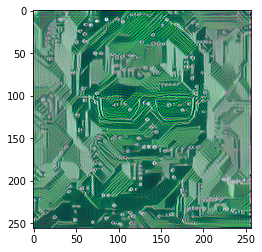

step: 95, loss: 300686.46875 (19.96s)


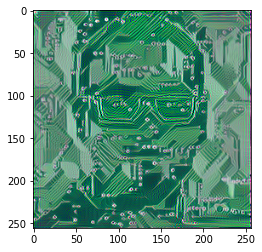

step: 96, loss: 298315.28125 (19.94s)


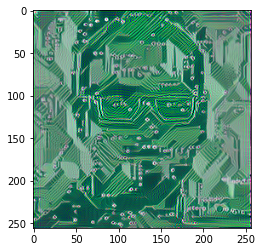

step: 97, loss: 296508.3125 (19.96s)


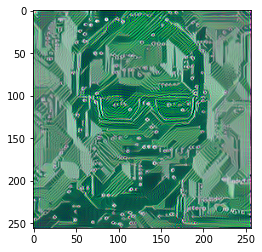

step: 98, loss: 294501.625 (20.32s)


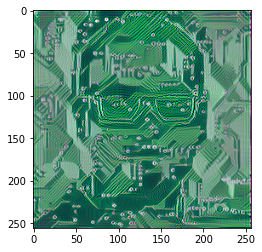

step: 99, loss: 292809.78125 (22.25s)


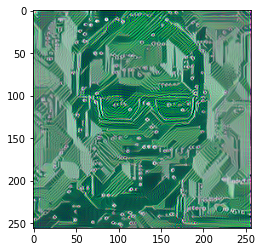

step: 100, loss: 291072.75 (19.95s)


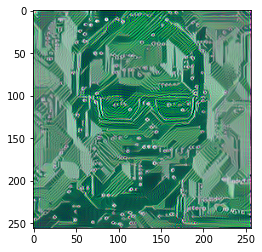

In [90]:
sys.path.append(os.path.join(base_dir, 'texture_synthesis_pytorch'))

import utilities
import model
import optimize

import importlib
importlib.reload(utilities)
importlib.reload(model)
importlib.reload(optimize)

lehl_img = utilities.load_image(os.path.join(im_dir, 'lehl_face.jpg'))
lehl_pre = utilities.preprocess_image(lehl_img)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

target_image = utilities.preprocess_image(utilities.load_image(os.path.join(im_dir, 'circuit_board.jpg')))

net = model.Model(os.path.join(base_dir, 'models', 'VGG19_normalized_avg_pool_pytorch'), device, target_image)

optimizer = optimize.Optimizer(net, args, start_image=lehl_pre)
result = optimizer.optimize()

final_image = utilities.postprocess_image(result, utilities.load_image(os.path.join(im_dir, 'circuit_board.jpg')))
final_image.save('output_lehl_face.png')


In [91]:
utilities.postprocess_image(lehl_pre, utilities.load_image(os.path.join(im_dir, 'circuit_board.jpg'))).save('lehl_face_initial.jpg')

for i, img in enumerate(optimizer.opt_images):
    img.save(f"lehl_circuit_{i}.jpg")

In [89]:
(lehl_pre.min(), lehl_pre.max(), target_image.min(), target_image.max())

(tensor(-121.6800), tensor(151.0610), tensor(-123.6800), tensor(133.2210))

In [66]:
inv_reparam_func = optimizer.get_inv_reparam_func(net.target_image)
dn_lehl = inv_reparam_func(lehl_pre.clamp(float(target_image.min()), float(target_image.max())))
rnd_pre = torch.randn_like(target_image)
dn_rand = inv_reparam_func(rnd_pre.clamp(float(target_image.min()), float(target_image.max())))


print('lehl', dn_lehl.min(), dn_lehl.max(), dn_lehl.mean(), dn_lehl.median(), dn_lehl.std())
print('random', dn_rand.min(), dn_rand.max(), dn_rand.mean(), dn_rand.median(), dn_rand.std())

print('target', target_image.min(), target_image.max(), target_image.mean(), target_image.median(), target_image.std())
print('lehl_pre', lehl_pre.min(), lehl_pre.max(), lehl_pre.mean(), lehl_pre.median(), lehl_pre.std())
print('rnd_pre', rnd_pre.min(), rnd_pre.max(), rnd_pre.mean(), rnd_pre.median(), rnd_pre.std())

lehl_pre2 = torch.div(lehl_pre, 2)
print('lehl_pre', lehl_pre2.min(), lehl_pre2.max(), lehl_pre2.mean(), lehl_pre2.median(), lehl_pre2.std())

dn_lehl2 = inv_reparam_func(lehl_pre2)
print('lehl', dn_lehl2.min(), dn_lehl2.max(), dn_lehl2.mean(), dn_lehl2.median(), dn_lehl2.std())

lehl tensor(-inf) tensor(inf) tensor(nan) tensor(1.5093) tensor(nan)
random tensor(-0.2666) tensor(-0.1395) tensor(-0.2000) tensor(-0.1999) tensor(0.0147)
target tensor(-123.6800) tensor(151.0610) tensor(19.7419) tensor(33.0610) tensor(56.3566)
lehl_pre tensor(-123.6800) tensor(151.0610) tensor(86.7149) tensor(101.3200) tensor(38.7366)
rnd_pre tensor(-4.5122) tensor(4.1224) tensor(0.0028) tensor(0.0050) tensor(0.9991)
lehl_pre tensor(-61.8400) tensor(75.5305) tensor(43.3574) tensor(50.6600) tensor(19.3683)
lehl tensor(-1.2363) tensor(0.9698) tensor(0.4447) tensor(0.5518) tensor(0.2929)
